In [1]:
import SimpleITK as sitk
import numpy as np
import matplotlib.pyplot as plt


def load_itk(filename):
    """This funciton reads a '.mhd' file using SimpleITK 
    and return the image array, origin and spacing of the image.
    """
    # Reads the image using SimpleITK
    itkimage = sitk.ReadImage(filename)

    # Convert the image to a  numpy array first and then 
    # shuffle the dimensions to get axis in the order z,y,x
    ct_scan = sitk.GetArrayFromImage(itkimage)

    # Read the origin of the ct_scan, will be used to convert
    # the coordinates from world to voxel and vice versa.
    origin = np.array(list(reversed(itkimage.GetOrigin())))

    # Read the spacing along each dimension
    spacing = np.array(list(reversed(itkimage.GetSpacing())))

    return ct_scan, origin, spacing

In [2]:
# from mpl_toolkits import mplot3d
from skimage import measure, morphology
from mpl_toolkits.mplot3d.art3d import Poly3DCollection


def plot_3d(image, threshold=0.2):
    
    # Position the scan upright, 
    # so the head of the patient would be at the top facing the camera
    p = image.transpose(2,1,0)
    
    verts, faces = measure.marching_cubes_classic(p, level=threshold)

    fig = plt.figure(figsize=(10, 10))
    ax = fig.add_subplot(111, projection='3d')

    # Fancy indexing: `verts[faces]` to generate a collection of triangles
    mesh = Poly3DCollection(verts[faces], alpha=0.70)
    face_color = [0.45, 0.45, 0.75]
    mesh.set_facecolor(face_color)
    ax.add_collection3d(mesh)

    ax.set_xlim(0, p.shape[0])
    ax.set_ylim(0, p.shape[1])
    ax.set_zlim(0, p.shape[2])

    plt.show()
    
# EXAMPLE:
# plot_3d(seg_rs[0], threshold=0)  # theshold choosed manually

### Diseased patients

(512, 512, 272)
(512, 512, 272)
(272, 224, 224, 3)


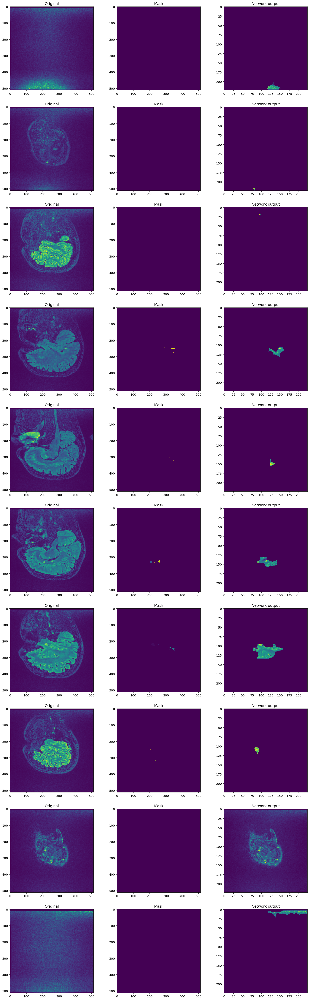

In [3]:
img_flair_rs = load_itk('AR-2/AX FLAIR AR 2.mhd')
print(img_flair_rs[0].shape)

seg_rs = load_itk('AR-2/Segmentation_1-label.mhd')
print(seg_rs[0].shape)

net_out = load_itk('net_out_masks/AR-2_rs_mask.mhd')
print(net_out[0].shape)

N_SLICES = 10
depth = img_flair_rs[0].shape[2]
step = depth // (N_SLICES - 1)
fig, ax = plt.subplots(N_SLICES, 3, figsize=(18, 6 * N_SLICES))

for n in range(0, depth, step):
    ax[n // step, 0].imshow(img_flair_rs[0][:,:, n])
    ax[n // step, 0].set_title('Original')
    ax[n // step, 1].imshow(seg_rs[0][:,:, n])
    ax[n // step, 1].set_title('Mask')
    ax[n // step, 2].imshow(net_out[0][n,:,:,0])
    ax[n // step, 2].set_title('Network output');

(512, 512, 130)
(512, 512, 130)
(130, 224, 224, 3)


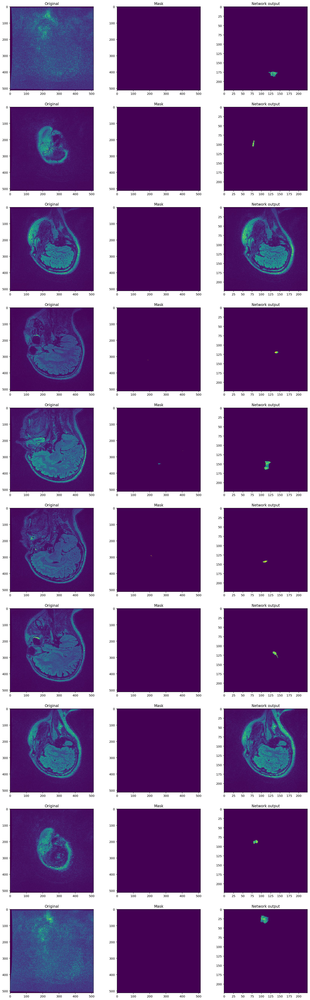

In [4]:
img_flair_rs = load_itk('AR-3/Ax 3D Cube FLAIR AR-3.mhd')
print(img_flair_rs[0].shape)

seg_rs = load_itk('AR-3/Segmentation_2-label.mhd')
print(seg_rs[0].shape)

net_out = load_itk('net_out_masks/AR-3_rs_mask.mhd')
print(net_out[0].shape)



N_SLICES = 10
depth = img_flair_rs[0].shape[2]
step = depth // (N_SLICES - 1)
fig, ax = plt.subplots(N_SLICES, 3, figsize=(18, 6 * N_SLICES))

for n in range(0, depth, step):
    ax[n // step, 0].imshow(img_flair_rs[0][:,:, n])
    ax[n // step, 0].set_title('Original')
    ax[n // step, 1].imshow(seg_rs[0][:,:, n])
    ax[n // step, 1].set_title('Mask')
    ax[n // step, 2].imshow(net_out[0][n,:,:,0])
    ax[n // step, 2].set_title('Network output');

(256, 256, 172)
(256, 256, 172)
(172, 224, 224, 3)


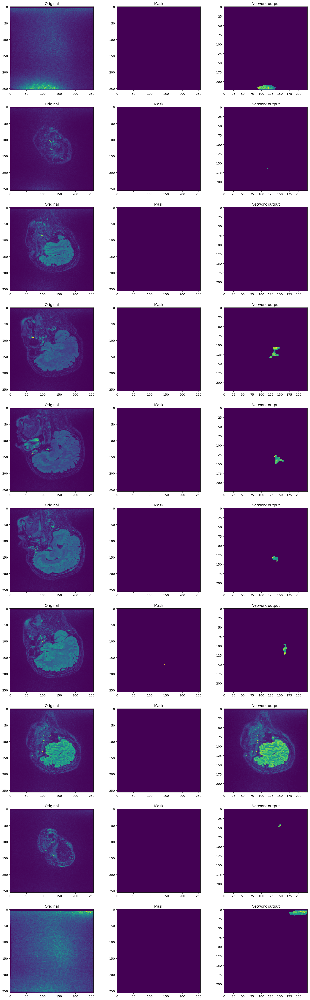

In [5]:
img_flair_rs = load_itk('AR-9/AX FLAIR AR-9.mhd')
print(img_flair_rs[0].shape)

seg_rs = load_itk('AR-9/Segmentation_3-label.mhd')
print(seg_rs[0].shape)

net_out = load_itk('net_out_masks/AR-9_rs_mask.mhd')
print(net_out[0].shape)



N_SLICES = 10
depth = img_flair_rs[0].shape[2]
step = depth // (N_SLICES - 1)
fig, ax = plt.subplots(N_SLICES, 3, figsize=(18, 6 * N_SLICES))

for n in range(0, depth, step):
    ax[n // step, 0].imshow(img_flair_rs[0][:,:, n])
    ax[n // step, 0].set_title('Original')
    ax[n // step, 1].imshow(seg_rs[0][:,:, n])
    ax[n // step, 1].set_title('Mask')
    ax[n // step, 2].imshow(net_out[0][n,:,:,0])
    ax[n // step, 2].set_title('Network output');

(512, 512, 252)
(512, 512, 252)
(252, 224, 224, 3)


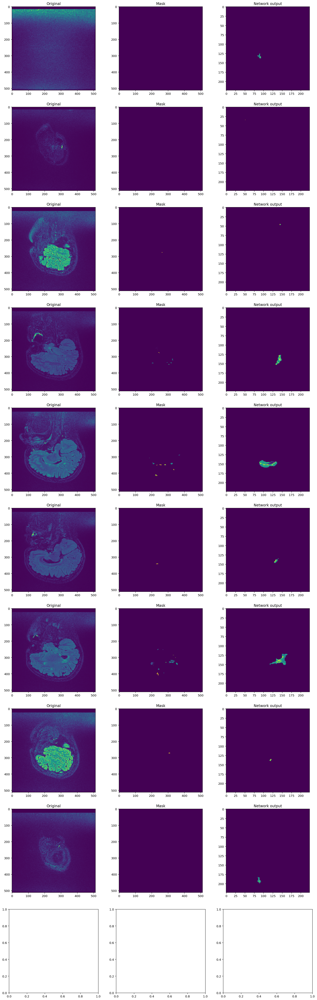

In [6]:
img_flair_rs = load_itk('AR-1/ax CUBE flair ar-1_2.mhd')
print(img_flair_rs[0].shape)

seg_rs = load_itk('AR-1/Segmentation-label.mhd')
print(seg_rs[0].shape)

net_out = load_itk('net_out_masks/AR-1_rs_mask.mhd')
print(net_out[0].shape)



N_SLICES = 10
depth = img_flair_rs[0].shape[2]
step = depth // (N_SLICES - 1)
fig, ax = plt.subplots(N_SLICES, 3, figsize=(18, 6 * N_SLICES))

for n in range(0, depth, step):
    ax[n // step, 0].imshow(img_flair_rs[0][:,:, n])
    ax[n // step, 0].set_title('Original')
    ax[n // step, 1].imshow(seg_rs[0][:,:, n])
    ax[n // step, 1].set_title('Mask')
    ax[n // step, 2].imshow(net_out[0][n,:,:,0])
    ax[n // step, 2].set_title('Network output');

### Healthy patients

(24, 512, 512)
(24, 512, 512)
(24, 224, 224, 3)


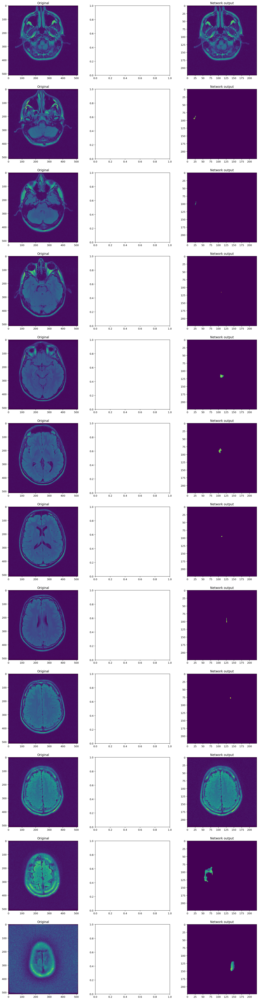

In [7]:
img_flair_rs = load_itk('AR-17/AX T2 FLAIR norma rs 7_1.mhd')
print(img_flair_rs[0].shape)

seg_rs = load_itk('AR-17/AX T2 FLAIR norma rs 7_1.mhd')
print(seg_rs[0].shape)

net_out = load_itk('net_out_masks/AR-17_rs_mask.mhd')
print(net_out[0].shape)



N_SLICES = 12
depth = img_flair_rs[0].shape[0]
step = depth // (N_SLICES - 1)
fig, ax = plt.subplots(N_SLICES, 3, figsize=(18, 6 * N_SLICES))

for n in range(1, depth, step):
    ax[n // step, 0].imshow(img_flair_rs[0][n,:, :])
    ax[n // step, 0].set_title('Original')
#     ax[n // step, 1].imshow(seg_rs[0][n, :, :])
#     ax[n // step, 1].set_title('Mask')
    ax[n // step, 2].imshow(net_out[0][n,:,:,0])
    ax[n // step, 2].set_title('Network output');

(20, 512, 512)
(20, 224, 224, 3)


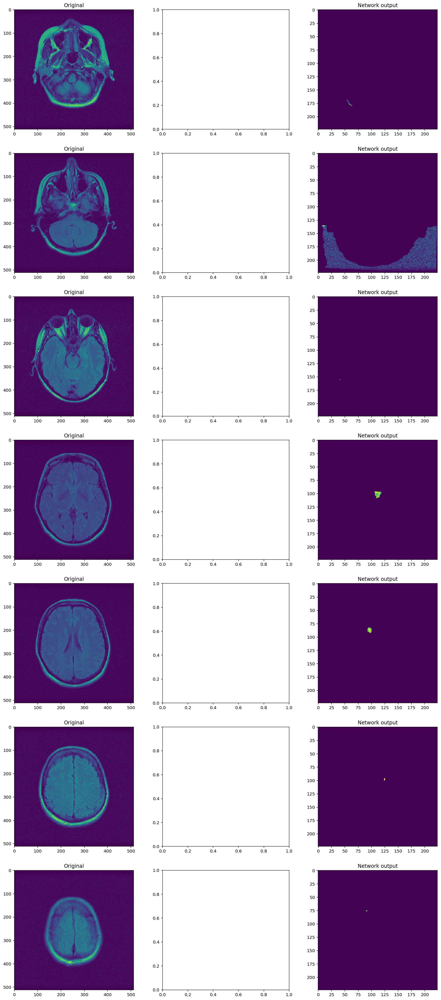

In [12]:
img_flair_rs = load_itk('AR-12/ax flair norma 2 rs.mhd')
print(img_flair_rs[0].shape)

# seg_rs = load_itk('AR-17/AX T2 FLAIR norma rs 7_1.mhd')
# print(seg_rs[0].shape)

net_out = load_itk('net_out_masks/AR-12_rs_mask.mhd')
print(net_out[0].shape)



N_SLICES = 7
depth = img_flair_rs[0].shape[0]
step = depth // (N_SLICES - 1)
fig, ax = plt.subplots(N_SLICES, 3, figsize=(18, 6 * N_SLICES))

for n in range(1, depth, step):
    ax[n // step, 0].imshow(img_flair_rs[0][n,:, :])
    ax[n // step, 0].set_title('Original')
#     ax[n // step, 1].imshow(seg_rs[0][n, :, :])
#     ax[n // step, 1].set_title('Mask')
    ax[n // step, 2].imshow(net_out[0][n,:,:,0])
    ax[n // step, 2].set_title('Network output');

(20, 512, 512)
(20, 224, 224, 3)


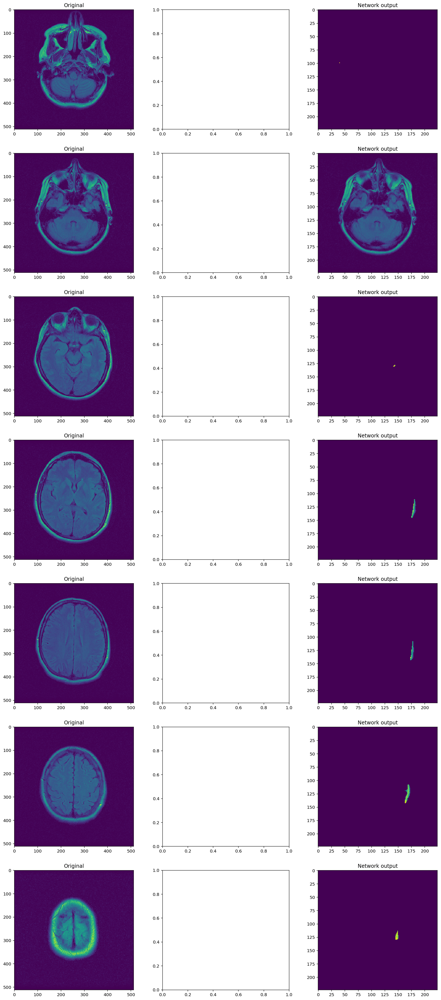

In [15]:
img_flair_rs = load_itk('AR-19/Ax Flair irFSE norma rs 9.mhd')
print(img_flair_rs[0].shape)

# seg_rs = load_itk('AR-17/AX T2 FLAIR norma rs 7_1.mhd')
# print(seg_rs[0].shape)

net_out = load_itk('net_out_masks/AR-19_rs_mask.mhd')
print(net_out[0].shape)



N_SLICES = 7
depth = img_flair_rs[0].shape[0]
step = depth // (N_SLICES - 1)
fig, ax = plt.subplots(N_SLICES, 3, figsize=(18, 6 * N_SLICES))

for n in range(1, depth, step):
    ax[n // step, 0].imshow(img_flair_rs[0][n,:, :])
    ax[n // step, 0].set_title('Original')
#     ax[n // step, 1].imshow(seg_rs[0][n, :, :])
#     ax[n // step, 1].set_title('Mask')
    ax[n // step, 2].imshow(net_out[0][n,:,:,0])
    ax[n // step, 2].set_title('Network output');

In [ ]:
seg_rs = load_itk('net_out_masks/AR-17_rs_mask.mhd')
seg_rs[0].shape

In [ ]:
plot_3d(seg_rs[0][:,:,:,0], threshold=100)

In [ ]:
seg_rs = load_itk('net_out_masks/AR-7_rs_mask.mhd')
seg_rs[0].shape

In [ ]:
plot_3d(seg_rs[0][:,:,:,0], threshold=100)

In [ ]:
plt.imshow(seg_rs[0][8,:,:,0])

In [ ]:
seg_rs[0][8,:,:,0]

In [ ]:
!pwd